# Pix2Pix Gan


O primeiro foco deste trabalho será explorar a arquitetura pix2pix Gan e o impacto de diferentes tipos de losses em diferentes datasets.

A arquitetura pix2pix aprende um mapeamento da imagem input para output, sendo que possui várias aplicações nomeadamente sintetizar fotos de labels ou por exemplo gerar fotos coloridas de fotos a preto e branco.

A sua arquitetura pode ser vista da seguinte forma:

- Um gerador com uma arquitetura U-Net
- Um discriminador que é representado por uma rede convolucional PatchGan

O Pix2Pix model é um modelo baseado em GAN condicional onde a geração de imagens output é condicionada pela imagem input.



## Pix2Pix Gan Implementation

#### Load the dataset

In [1]:
import tensorflow as tf

import os
import pathlib
import time
import datetime

from matplotlib import pyplot as plt
from IPython import display

In [ ]:
dataset_name = "facades"

In [ ]:
_URL = f'http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/{dataset_name}.tar.gz'

path_to_zip = tf.keras.utils.get_file(
    fname=f"{dataset_name}.tar.gz",
    origin=_URL,
    extract=True)

path_to_zip  = pathlib.Path(path_to_zip)

PATH = path_to_zip.parent/dataset_name

In [ ]:
sample_image = tf.io.read_file(str(PATH / 'train/1.jpg'))
sample_image = tf.io.decode_jpeg(sample_image)
print(sample_image.shape)

(256, 512, 3)


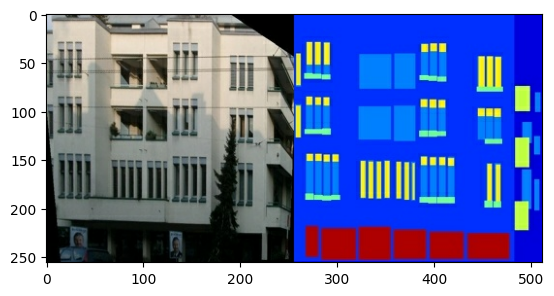

In [ ]:
plt.figure()
plt.imshow(sample_image)

In [ ]:
# Separating real image from architecture label

def load(image_file):
  # Read and decode an image file to a uint8 tensor
  image = tf.io.read_file(image_file)
  image = tf.io.decode_jpeg(image)

  # Split each image tensor into two tensors:
  # - one with a real building facade image
  # - one with an architecture label image 
  w = tf.shape(image)[1]
  w = w // 2
  input_image = image[:, w:, :]
  real_image = image[:, :w, :]

  # Convert both images to float32 tensors
  input_image = tf.cast(input_image, tf.float32)
  real_image = tf.cast(real_image, tf.float32)

  return input_image, real_image

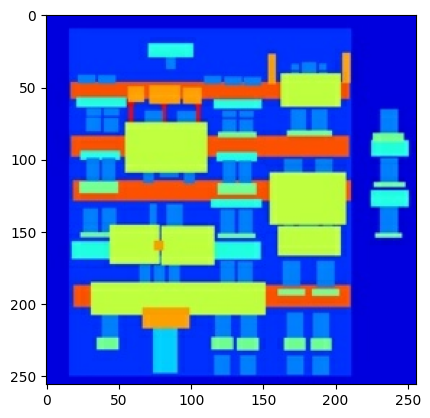

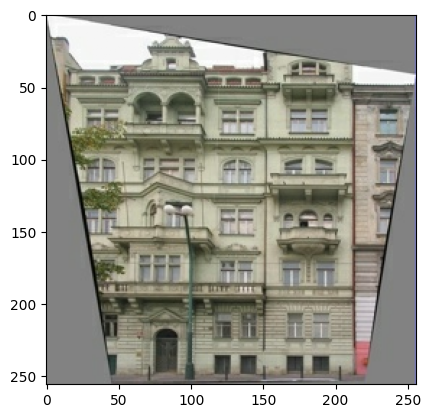

In [ ]:
inp, re = load(str(PATH / 'train/100.jpg'))
# Casting to int for matplotlib to display the images
plt.figure()
plt.imshow(inp / 255.0)
plt.figure()
plt.imshow(re / 255.0)

Como descrito no paper pix2pix é necessário aplicar random jittering e mirroring ao pre processamento

In [2]:
# The facade training set consist of 400 images
BUFFER_SIZE = 400
# The batch size of 1 produced better results for the U-Net in the original pix2pix experiment
BATCH_SIZE = 1
# Each image is 256x256 in size
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [3]:
def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],
                                method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  real_image = tf.image.resize(real_image, [height, width],
                               method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  return input_image, real_image

In [4]:
def random_crop(input_image, real_image):
  stacked_image = tf.stack([input_image, real_image], axis=0)
  cropped_image = tf.image.random_crop(
      stacked_image, size=[2, IMG_HEIGHT, IMG_WIDTH, 3])

  return cropped_image[0], cropped_image[1]

In [5]:
def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image

In [6]:
@tf.function()
def random_jitter(input_image, real_image):
  # Resizing to 286x286
  input_image, real_image = resize(input_image, real_image, 286, 286)

  # Random cropping back to 256x256
  input_image, real_image = random_crop(input_image, real_image)

  if tf.random.uniform(()) > 0.5:
    # Random mirroring
    input_image = tf.image.flip_left_right(input_image)
    real_image = tf.image.flip_left_right(real_image)

  return input_image, real_image

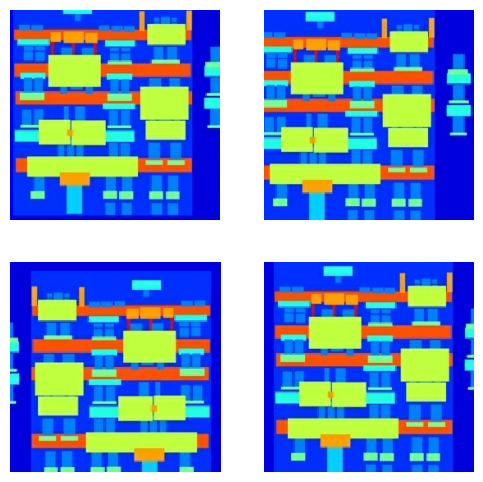

In [ ]:
plt.figure(figsize=(6, 6))
for i in range(4):
  rj_inp, rj_re = random_jitter(inp, re)
  plt.subplot(2, 2, i + 1)
  plt.imshow(rj_inp / 255.0)
  plt.axis('off')
plt.show()

In [ ]:
def load_image_train(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = random_jitter(input_image, real_image)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [ ]:
def load_image_test(image_file):
  input_image, real_image = load(image_file)
  input_image, real_image = resize(input_image, real_image,
                                   IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [ ]:
train_dataset = tf.data.Dataset.list_files(str(PATH / 'train/*.jpg'))
train_dataset = train_dataset.map(load_image_train,
                                  num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

In [ ]:
try:
  test_dataset = tf.data.Dataset.list_files(str(PATH / 'test/*.jpg'))
except tf.errors.InvalidArgumentError:
  test_dataset = tf.data.Dataset.list_files(str(PATH / 'val/*.jpg'))
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

#### Construindo o Generator

O generator é baseado numa arquitetura U-Net e consiste num encoder e num decoder e a sua caraterística principal é o facto de poderem haver conexões "skip" entre o decoder e o encoder.

In [7]:
OUTPUT_CHANNELS = 3

In [8]:
def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result

In [ ]:
down_model = downsample(3, 4)
down_result = down_model(tf.expand_dims(inp, 0))
print (down_result.shape)

In [9]:
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

In [ ]:
up_model = upsample(3, 4)
up_result = up_model(down_result)
print (up_result.shape)

In [10]:
def Generator():
  inputs = tf.keras.layers.Input(shape=[256, 256, 3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False),  # (batch_size, 128, 128, 64)
    downsample(128, 4),  # (batch_size, 64, 64, 128)
    downsample(256, 4),  # (batch_size, 32, 32, 256)
    downsample(512, 4),  # (batch_size, 16, 16, 512)
    downsample(512, 4),  # (batch_size, 8, 8, 512)
    downsample(512, 4),  # (batch_size, 4, 4, 512)
    downsample(512, 4),  # (batch_size, 2, 2, 512)
    downsample(512, 4),  # (batch_size, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True),  # (batch_size, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True),  # (batch_size, 8, 8, 1024)
    upsample(512, 4),  # (batch_size, 16, 16, 1024)
    upsample(256, 4),  # (batch_size, 32, 32, 512)
    upsample(128, 4),  # (batch_size, 64, 64, 256)
    upsample(64, 4),  # (batch_size, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh')  # (batch_size, 256, 256, 3)

  x = inputs

  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)

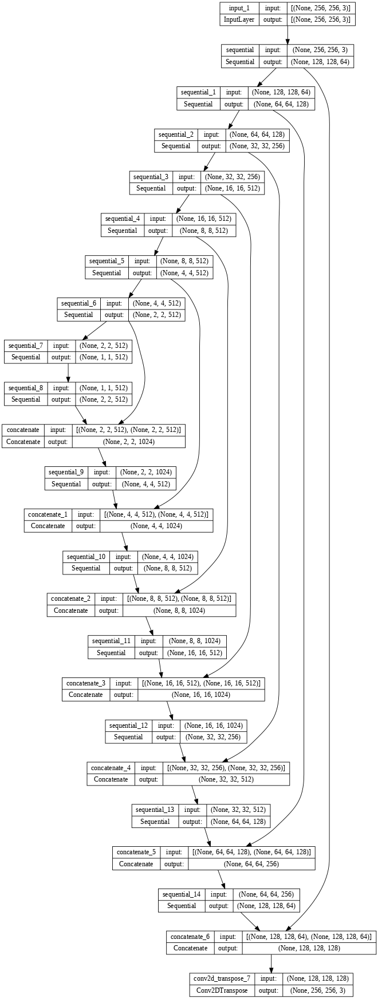

In [11]:
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)

#### Generator Loss

A loss do gerador é uma função sigmoid cross-entropy da imagem gerada e um array de 1's. Para além desta loss os autores utilizam uma L1 loss que é uma MSE da imagem gerada e a target image,permitindo que a imagem gerada seja estruturalmente mais parecida com a real.

A fórmula utilizada é assim gLoss = gan_loss + LAMBDA * L1_loss, onde Lambda = 100 segundo os autores.

In [12]:
LAMBDA = 100

In [13]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)

In [14]:
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # Mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

#### Discriminator

O discriminador na Pix2Pix cGAN é um classificador convolucional PatchGAN, sendo que tenta classificar se cada *patch* da imagem é real ou não. Este recebe 2 inputs: a imagem input e a target tentando classificar qual é real, e a imagem input a a gerada que deveser classifcada como falsa.



In [15]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.02)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar])  # (batch_size, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x)  # (batch_size, 128, 128, 64)
  down2 = downsample(128, 4)(down1)  # (batch_size, 64, 64, 128)
  down3 = downsample(256, 4)(down2)  # (batch_size, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (batch_size, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)  # (batch_size, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (batch_size, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)  # (batch_size, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

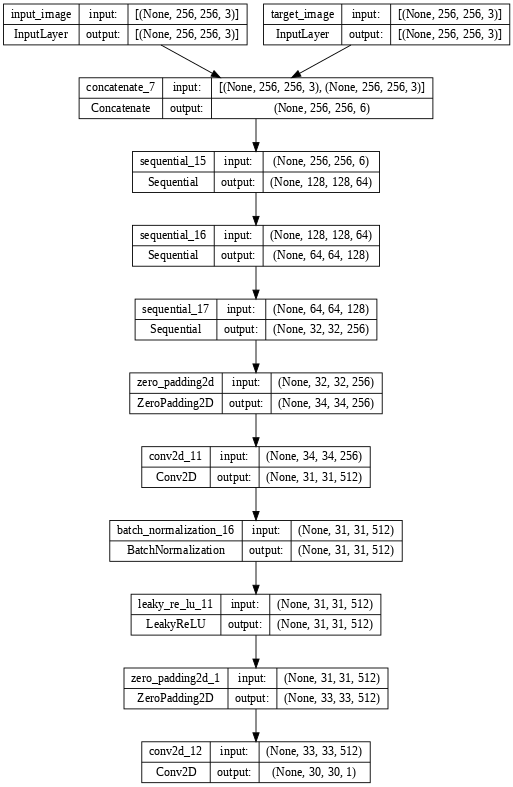

In [16]:
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

In [17]:
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

In [18]:
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

In [19]:
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [20]:
log_dir="logs/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

In [21]:
@tf.function
def train_step(input_image, target, step):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=step//1000)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=step//1000)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=step//1000)
    tf.summary.scalar('disc_loss', disc_loss, step=step//1000)

In [22]:
from skimage.metrics import structural_similarity as ssim
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(15, 15))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # Getting the pixel values in the [0, 1] range to plot.
    ssim1 = tf.image.ssim(tar, prediction, max_val=1.0)
    rmse = tf.sqrt(tf.reduce_mean(tf.math.squared_difference(tar,prediction )))




    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()
  return ssim1,rmse

In [23]:
def fit(train_ds, test_ds, steps):
  example_input, example_target = next(iter(test_ds.take(1)))
  start = time.time()

  for step, (input_image, target) in train_ds.repeat().take(steps).enumerate():
    if (step) % 1000 == 0:
      display.clear_output(wait=True)

      if step != 0:
        print(f'Time taken for 1000 steps: {time.time()-start:.2f} sec\n')

      start = time.time()

      ss,rmse = generate_images(generator, example_input, example_target)
      print(f"Step: {step//1000}k")
      print(f"SSIM: {ss}")
      print(f"RMSE: {rmse}")
    train_step(input_image, target, step)

    # Training step
    if (step+1) % 10 == 0:
      print('.', end='', flush=True)


    # Save (checkpoint) the model every 5k steps
    if (step + 1) % 5000 == 0:
      checkpoint.save(file_prefix=checkpoint_prefix)

In [ ]:
fit(train_dataset, test_dataset, steps=40000)

### Stanford Dogs
Loading the Stanford Dog dataset. Link https://www.kaggle.com/datasets/jessicali9530/stanford-dogs-dataset

De notar que a função que faz a leitura deste dataset, cria um novo dataset onde se extraem os contornos através do método de Canny. Para melhores resultados, estes métodos de extração de contornos deviam ser melhorados.

In [24]:
from google.colab import drive
drive.mount('/content/drive',force_remount=True)

Mounted at /content/drive


In [ ]:
!unzip /content/drive/MyDrive/dogs.zip -d /content/


unzip:  cannot find or open /content/drive/MyDrive/dogs.zip, /content/drive/MyDrive/dogs.zip.zip or /content/drive/MyDrive/dogs.zip.ZIP.


In [ ]:
#PATH =  "/mnt/c/users/uncha/Documents/Masters/VCPI/dogs/Images/*/*.jpg"
PATH = "/content/dogs/Images/*/*.jpg"

In [24]:
import cv2
# Separating real image from architecture label

def load_stanford(image_file):
  # Read and decode an image file to a uint8 tensor
  image = tf.io.read_file(image_file)
  image = tf.io.decode_jpeg(image,channels=3)

  # Split each image tensor into two tensors:
  # - one with a real building facade image
  # - one with an architecture label image 
  # Convert both images to float32 tensors
  
  image_in = tf.io.read_file(image_file)
  image_in = tf.io.decode_jpeg(image_in,channels=3)
  input_image = tf.image.resize(image_in, [256,256])
  input_image = tf.cast(input_image,tf.uint8)
  input_image = cv2.Canny(input_image.numpy(),100,100)
  input_image = cv2.cvtColor(input_image, cv2.COLOR_GRAY2RGB)
  input_image = tf.convert_to_tensor(input_image, dtype=tf.float32)


  
  real_image = tf.image.resize(image, [256,256])
  input_image = tf.cast(input_image, tf.float32)
  real_image = tf.cast(real_image, tf.float32)


  return input_image, real_image

In [ ]:
inp, re = load_stanford(str(PATH))
# Casting to int for matplotlib to display the images
plt.figure()
plt.imshow(inp / 255.0)
plt.figure()
plt.imshow(re / 255.0)

In [25]:
def load_image_train_stanford(input_image,real_image):
  input_image, real_image = random_jitter(input_image, real_image)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [33]:
def load_image_test_stanford(input_image,real_image):
  input_image, real_image = resize(input_image, real_image,
                                   IMG_HEIGHT, IMG_WIDTH)
  input_image, real_image = normalize(input_image, real_image)

  return input_image, real_image

In [26]:
    
def load_stan(img_file):
    [input_image,real_image] = tf.py_function(load_stanford, [img_file], [tf.float32,tf.float32])
    input_image.set_shape([256,256,3])
    real_image.set_shape([256,256,3])
    return input_image,real_image
    
    

In [ ]:
all_dataset = tf.data.Dataset.list_files(PATH)
all_dataset = all_dataset.map(load_stan,
                                  num_parallel_calls=tf.data.AUTOTUNE)
all_dataset = all_dataset.shuffle(BUFFER_SIZE)
train_set = all_dataset.take(int(0.8 * all_dataset.cardinality().numpy()))

train_dataset = train_set.map(load_image_train_stanford,
                                  num_parallel_calls=tf.data.AUTOTUNE)

train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

test_set = all_dataset.skip(int(0.8 * all_dataset.cardinality().numpy()))


test_set = test_set.map(load_image_test_stanford,
                                  num_parallel_calls=tf.data.AUTOTUNE)
test_set = test_set.batch(BATCH_SIZE)


In [ ]:
for inp, rea in train_dataset.take(1):
  print("Image shape: ", inp.numpy().shape)

  plt.imshow(rea )
  plt.show()

Time taken for 1000 steps: 105.15 sec



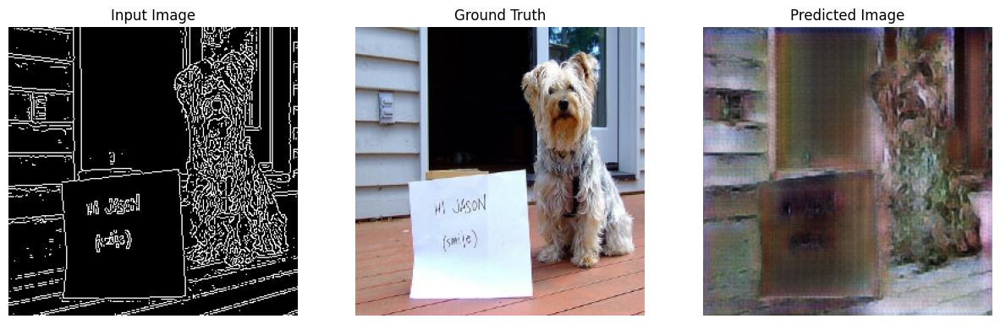

Step: 39k
SSIM: [0.02547039]
RMSE: 0.8020525574684143
....................................................................................................

In [ ]:
fit(train_dataset, test_set, steps=40000)

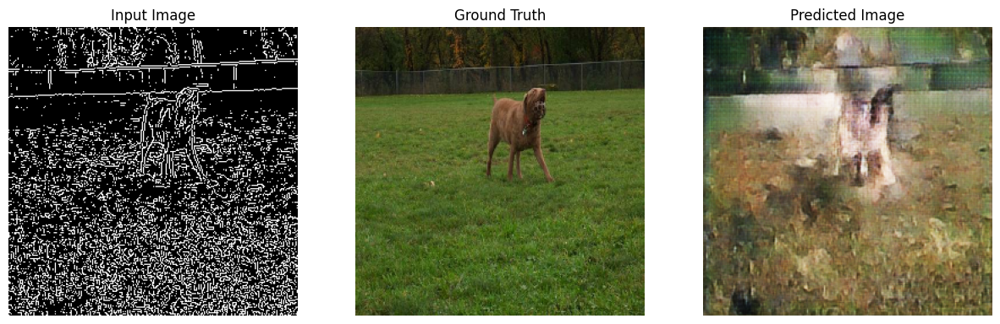

SSIM : [0.02937448]
RMSE : 0.4941122233867645


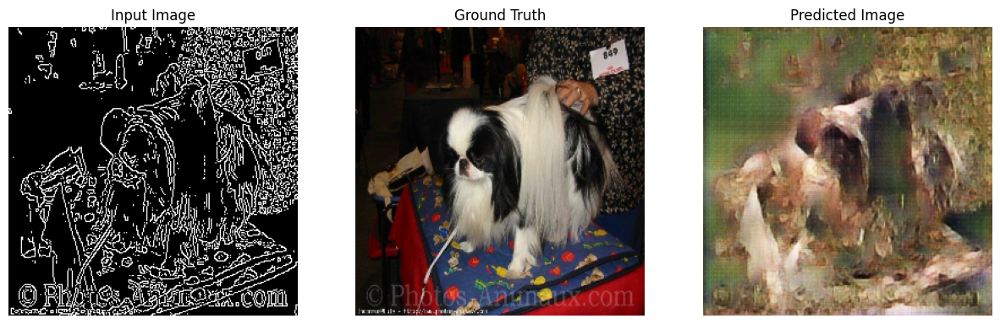

SSIM : [0.04577783]
RMSE : 0.6916384100914001


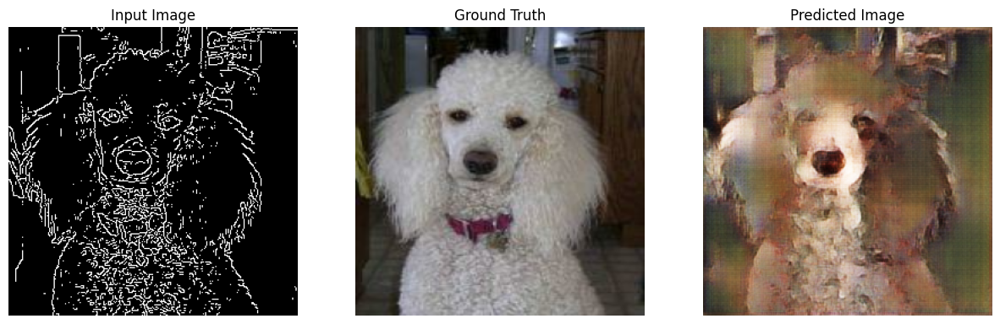

SSIM : [0.06261779]
RMSE : 0.43734967708587646


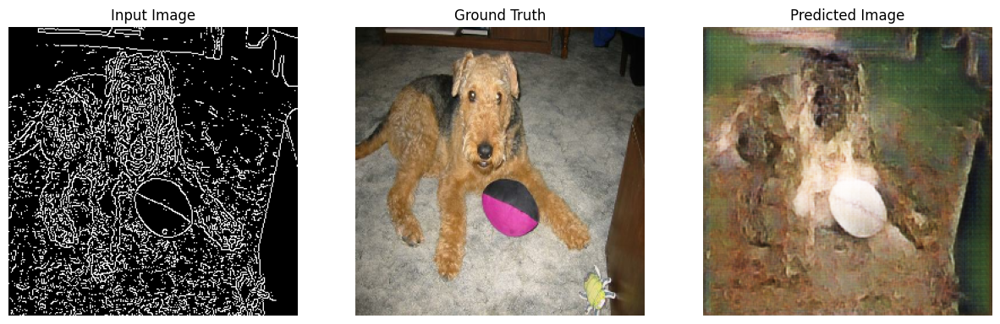

SSIM : [0.05205919]
RMSE : 0.49543604254722595


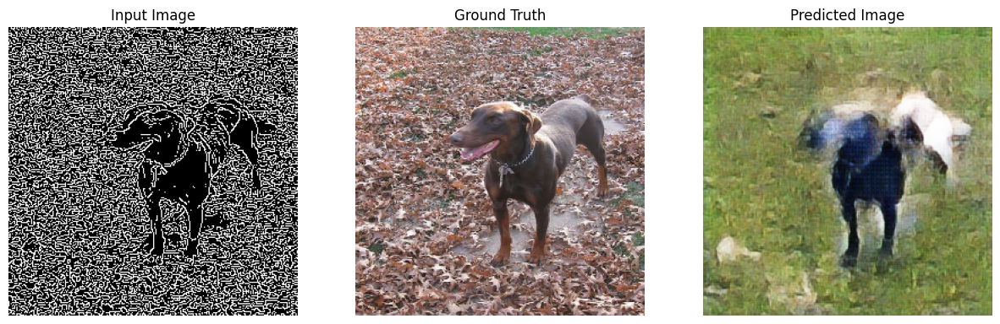

SSIM : [0.04315862]
RMSE : 0.45940643548965454


In [ ]:
for inp, tar in test_set.take(5):
  ssim,rmse= generate_images(generator, inp, tar)
  print(f"SSIM : {ssim}")
  print(f"RMSE : {rmse}")

Como podemos ver pelas imagens acima, os resultados não são muito bons e isso pode ser interpretado pelo fato do dataset ser pouco representativo e pelo facto das edges geradas não serem muito boas. No entanto, podemos ver que o modelo é capaz de gerar imagens dentro das bordas e elas têm a forma da imagem de entrada com cores diferentes.

## Lego dataset

Uma vez que o dataset anterior possuia bastante ruído, vamos analisar o desempenho do modelo num dataset mais "limpo".
Link https://www.kaggle.com/datasets/joosthazelzet/lego-brick-images


In [ ]:
!unzip /content/drive/MyDrive/lego.zip -d /content/

A saída de streaming foi truncada nas últimas 5000 linhas.
  inflating: /content/lego/3003 Brick 2x2/0213.png  
  inflating: /content/lego/3003 Brick 2x2/0214.png  
  inflating: /content/lego/3003 Brick 2x2/0215.png  
  inflating: /content/lego/3003 Brick 2x2/0216.png  
  inflating: /content/lego/3003 Brick 2x2/0217.png  
  inflating: /content/lego/3003 Brick 2x2/0218.png  
  inflating: /content/lego/3003 Brick 2x2/0219.png  
  inflating: /content/lego/3003 Brick 2x2/0220.png  
  inflating: /content/lego/3003 Brick 2x2/0221.png  
  inflating: /content/lego/3003 Brick 2x2/0222.png  
  inflating: /content/lego/3003 Brick 2x2/0223.png  
  inflating: /content/lego/3003 Brick 2x2/0224.png  
  inflating: /content/lego/3003 Brick 2x2/0225.png  
  inflating: /content/lego/3003 Brick 2x2/0226.png  
  inflating: /content/lego/3003 Brick 2x2/0227.png  
  inflating: /content/lego/3003 Brick 2x2/0228.png  
  inflating: /content/lego/3003 Brick 2x2/0229.png  
  inflating: /content/lego/3003 Brick 2x

In [ ]:
!unzip /content/drive/MyDrive/legoplus.zip -d /content/

In [ ]:
#PATH_LEGO = "/mnt/c/Users/uncha/Documents/Masters/VCPI/lego/*/*.png"
PATH_LEGO = "/content/lego/*/*.png"
PATH_LEGO_PLUS = "/content/legoplus/*/*.jpg"

In [ ]:
all_dataset = tf.data.Dataset.list_files(PATH_LEGO)
print(all_dataset.cardinality().numpy())
all_dataset = all_dataset.map(load_stan,
                                  num_parallel_calls=tf.data.AUTOTUNE)

all_dataset = all_dataset.shuffle(BUFFER_SIZE)
train_set = all_dataset.take(int(0.8 * all_dataset.cardinality().numpy()))

train_dataset = train_set.map(load_image_train_stanford,
                                  num_parallel_calls=tf.data.AUTOTUNE)

train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

test_set = all_dataset.skip(int(0.8 * all_dataset.cardinality().numpy()))


test_set = test_set.map(load_image_test_stanford,
                                  num_parallel_calls=tf.data.AUTOTUNE)
test_set = test_set.batch(BATCH_SIZE)

6379


Image shape:  (256, 256, 3)


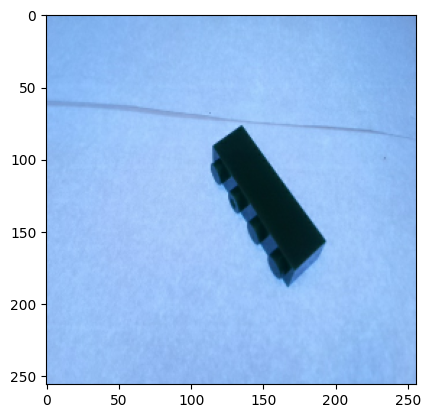

In [ ]:
for inp, rea in conc.take(1):
  print("Image shape: ", inp.numpy().shape)

  plt.imshow(rea/255 )
  plt.show()

Time taken for 1000 steps: 95.96 sec



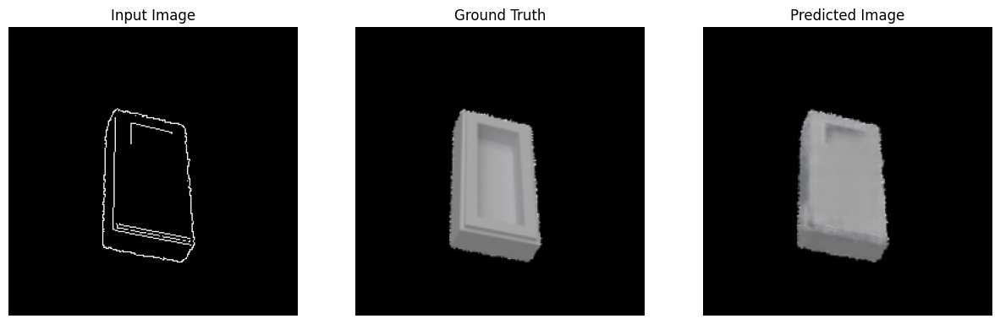

Step: 39k
SSIM: [0.9296055]
RMSE: 0.041540246456861496
....................................................................................................

In [ ]:
fit(train_dataset, test_set, steps=40000)

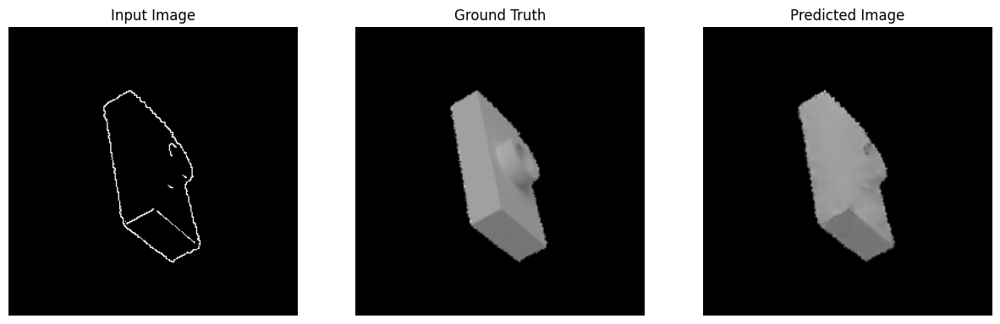

SSIM : [0.95093393]
RMSE : 0.039459966123104095


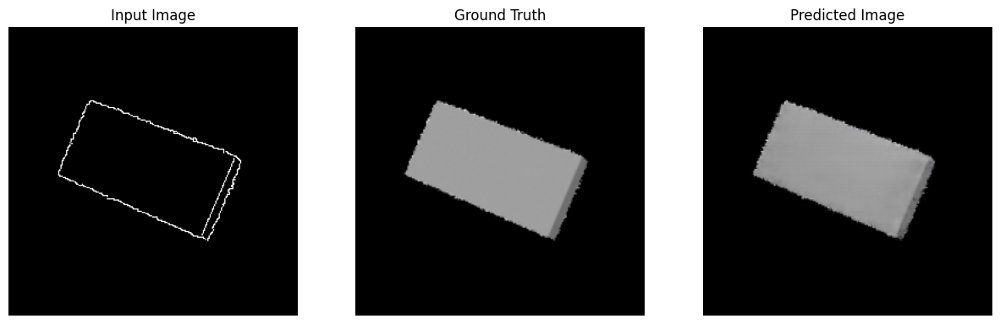

SSIM : [0.96048665]
RMSE : 0.04097634553909302


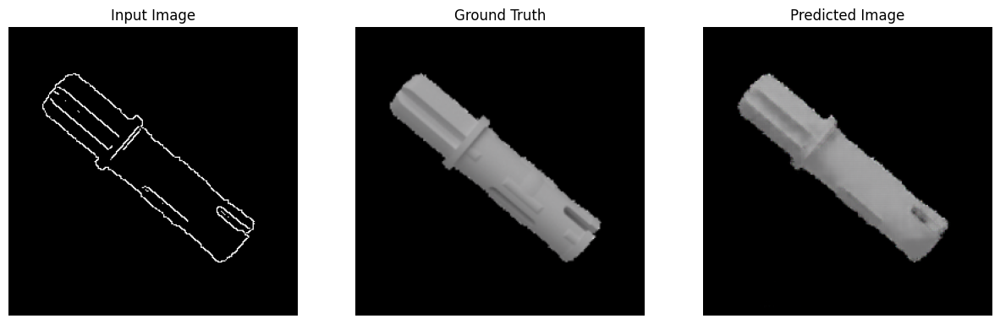

SSIM : [0.9275438]
RMSE : 0.04631319269537926


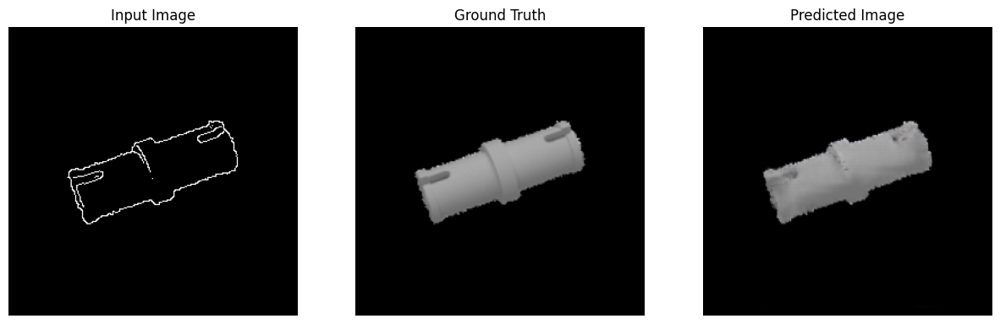

SSIM : [0.9504841]
RMSE : 0.041007500141859055


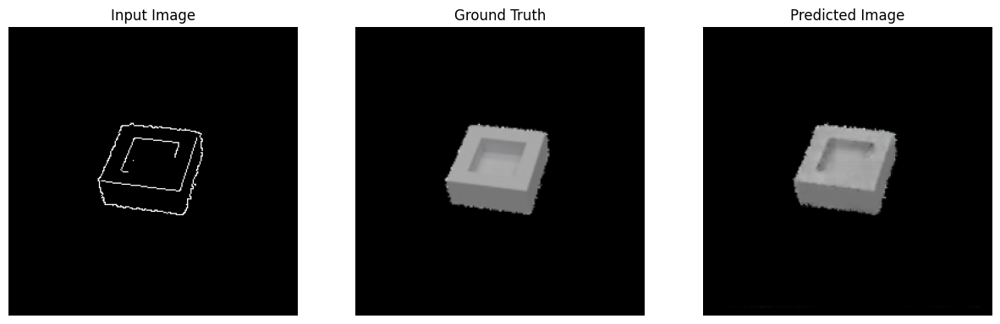

SSIM : [0.9657116]
RMSE : 0.03369458019733429


In [ ]:
for inp, tar in test_set.take(5):
  ssim,rmse= generate_images(generator, inp, tar)
  print(f"SSIM : {ssim}")
  print(f"RMSE : {rmse}")

In [ ]:
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # Mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = l1_loss

  return total_gen_loss, gan_loss, l1_loss

Time taken for 1000 steps: 91.30 sec



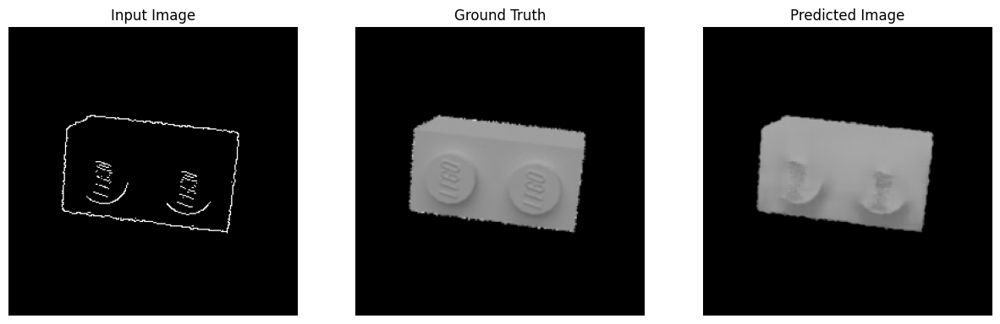

Step: 39k
SSIM: [0.9238021]
RMSE: 0.04550304636359215
....................................................................................................

In [ ]:
fit(train_dataset, test_set, steps=40000)

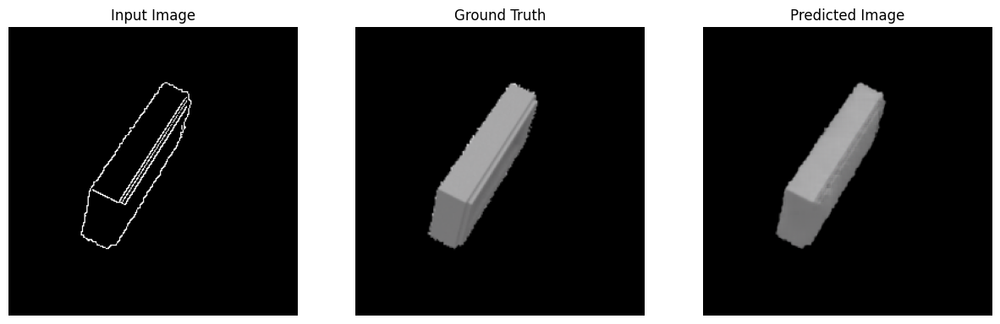

SSIM : [0.97165436]
RMSE : 0.030298631638288498


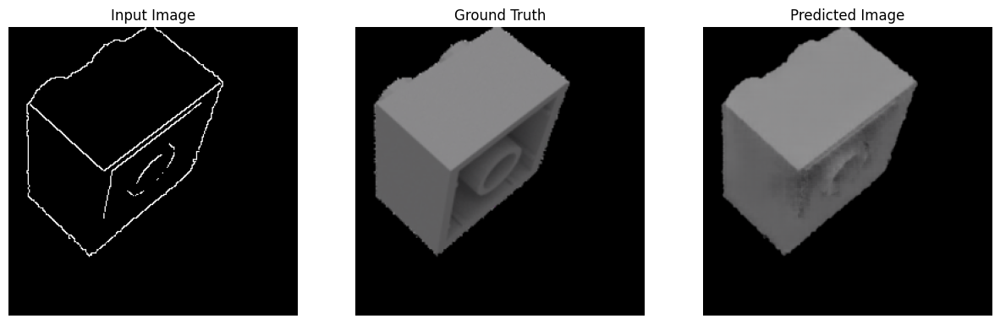

SSIM : [0.9249857]
RMSE : 0.05416223779320717


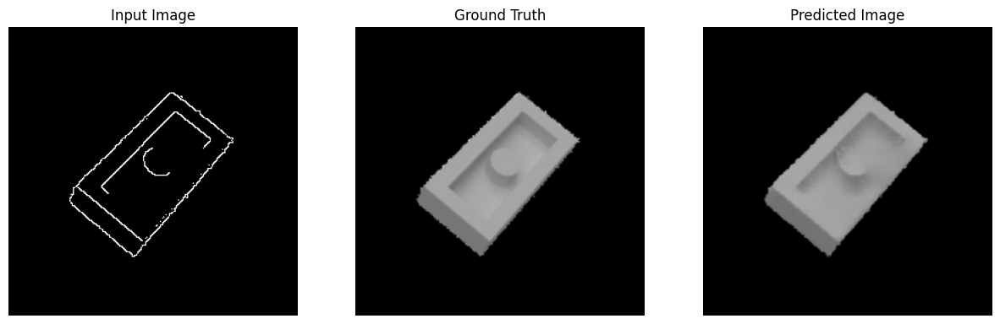

SSIM : [0.95808154]
RMSE : 0.03163981810212135


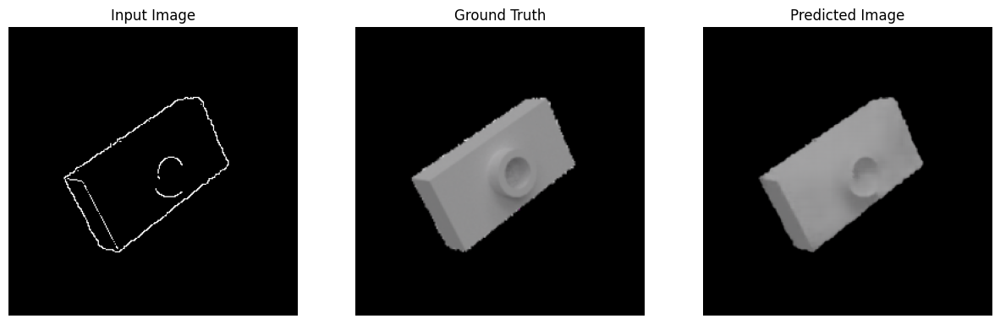

SSIM : [0.9500852]
RMSE : 0.03525533527135849


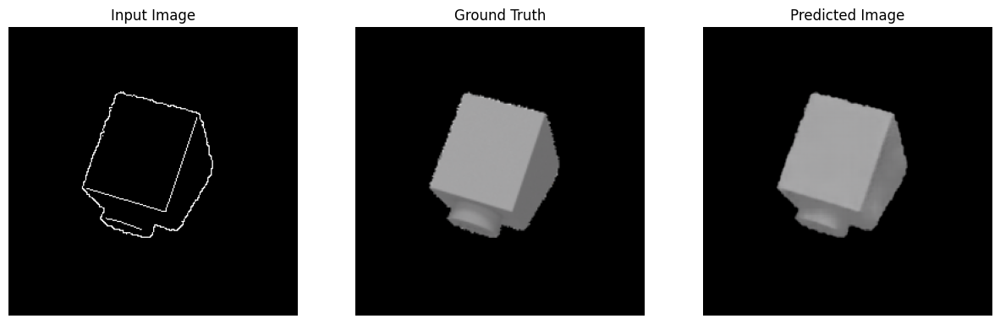

SSIM : [0.967803]
RMSE : 0.028409592807292938


In [ ]:
for inp, tar in test_set.take(5):
  ssim,rmse= generate_images(generator, inp, tar)
  print(f"SSIM : {ssim}")
  print(f"RMSE : {rmse}")

Como podemos ver pelos resultados acima, embora apenas a l1 seja usada o que causa os resultados um pouco mais blurried, em termos de objetividade os resultados obtidos da SSIM e RMSE continuam com valores otimais. Ou seja, a medida de similaridade estrutural (SSIM) continua perto de 1 e o RMSE continua perto de 0.

## Comic faces

Como mostrado pelos datasets anteriores o modelo pix2pix é capaz de gerar imagens a partir dos seus contornos, porém não é a sua única aplicabilidade. O dataset que irá ser explorado a seguir consiste em caras e a sua respetiva cartonização, e o objetivo do modelo será então produzir caras cartonizadas.
Link https://www.kaggle.com/datasets/defileroff/comic-faces-paired-synthetic

In [34]:
!unzip /content/drive/MyDrive/comic.zip -d /content/

A saída de streaming foi truncada nas últimas 5000 linhas.
  inflating: /content/comic/face/5499.jpg  
  inflating: /content/comic/face/55.jpg  
  inflating: /content/comic/face/550.jpg  
  inflating: /content/comic/face/5500.jpg  
  inflating: /content/comic/face/5501.jpg  
  inflating: /content/comic/face/5502.jpg  
  inflating: /content/comic/face/5503.jpg  
  inflating: /content/comic/face/5504.jpg  
  inflating: /content/comic/face/5505.jpg  
  inflating: /content/comic/face/5506.jpg  
  inflating: /content/comic/face/5507.jpg  
  inflating: /content/comic/face/5508.jpg  
  inflating: /content/comic/face/5509.jpg  
  inflating: /content/comic/face/551.jpg  
  inflating: /content/comic/face/5510.jpg  
  inflating: /content/comic/face/5511.jpg  
  inflating: /content/comic/face/5512.jpg  
  inflating: /content/comic/face/5513.jpg  
  inflating: /content/comic/face/5514.jpg  
  inflating: /content/comic/face/5515.jpg  
  inflating: /content/comic/face/5516.jpg  
  inflating: /content

In [27]:
def load_comic(real_file,comic_file):
  # Read and decode an image file to a uint8 tensor
  image_real = tf.io.read_file(real_file)
  image_real = tf.io.decode_jpeg(image_real,channels=3)

  # Split each image tensor into two tensors:
  # - one with a real building facade image
  # - one with an architecture label image 
  # Convert both images to float32 tensors
  
  image_out = tf.io.read_file(comic_file)
  image_out = tf.io.decode_jpeg(image_out,channels=3)
  input_image = tf.image.resize(image_real, [256,256]) 
  real_image = tf.image.resize(image_out, [256,256])
  
  input_image = tf.cast(input_image, tf.float32)
  real_image = tf.cast(real_image, tf.float32)


  return input_image, real_image

In [28]:
PATH_REAL ="/content/comic/face/*.jpg"
PATH_COMIC ="/content/comic/comics/*.jpg"


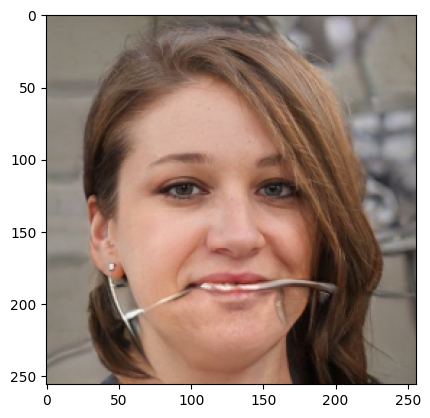

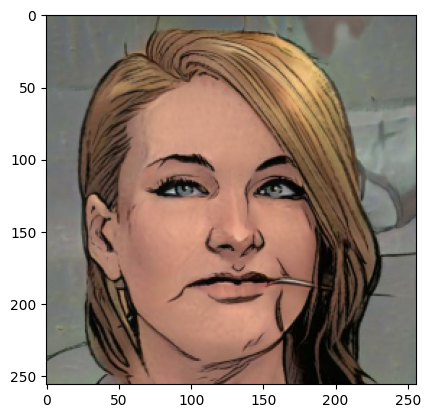

In [ ]:
inp, re = load_comic(str(PATH_REAL),str(PATH_COMIC))
# Casting to int for matplotlib to display the images
plt.figure()
plt.imshow(inp / 255.0)
plt.figure()
plt.imshow(re / 255.0)

In [29]:
# The facade training set consist of 400 images
BUFFER_SIZE = 400
# The batch size of 1 produced better results for the U-Net in the original pix2pix experiment
BATCH_SIZE = 1
# Each image is 256x256 in size
IMG_WIDTH = 256
IMG_HEIGHT = 256

In [34]:
real = tf.data.Dataset.list_files(PATH_REAL, shuffle=False)
comic = tf.data.Dataset.list_files(PATH_COMIC, shuffle=False)

all_dataset = tf.data.Dataset.zip((real, comic))
print(all_dataset.cardinality().numpy())
all_dataset = all_dataset.map(load_comic,
                                  num_parallel_calls=tf.data.AUTOTUNE)

all_dataset = all_dataset.shuffle(BUFFER_SIZE)
train_set = all_dataset.take(int(0.8 * all_dataset.cardinality().numpy()))

train_dataset = train_set.map(load_image_train_stanford,
                                  num_parallel_calls=tf.data.AUTOTUNE)

train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)

test_set = all_dataset.skip(int(0.8 * all_dataset.cardinality().numpy()))


test_set = test_set.map(load_image_test_stanford,
                                  num_parallel_calls=tf.data.AUTOTUNE)
test_set = test_set.batch(BATCH_SIZE)

10000


Time taken for 1000 steps: 98.03 sec



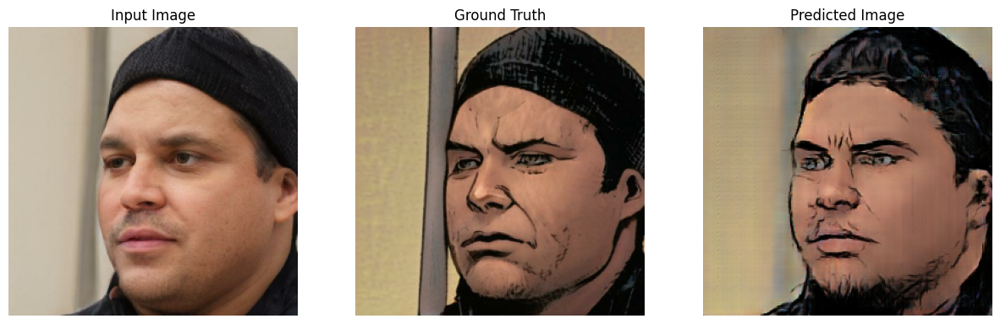

Step: 39k
SSIM: [0.28043026]
RMSE: 0.2424653172492981
....................................................................................................

In [ ]:
fit(train_dataset, test_set, steps=40000)

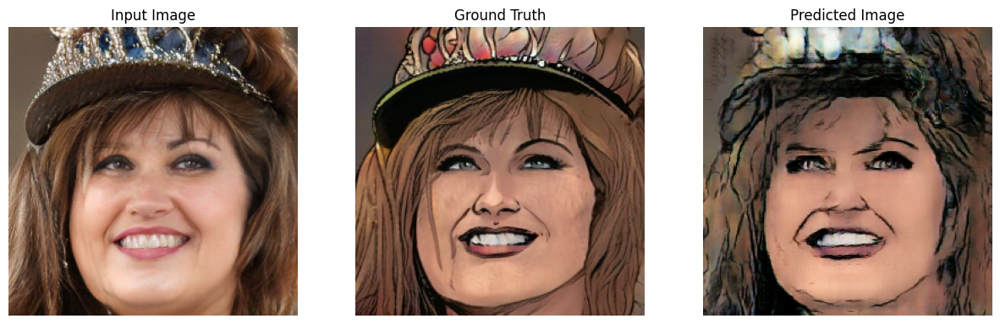

SSIM : [0.16861059]
RMSE : 0.3292277753353119


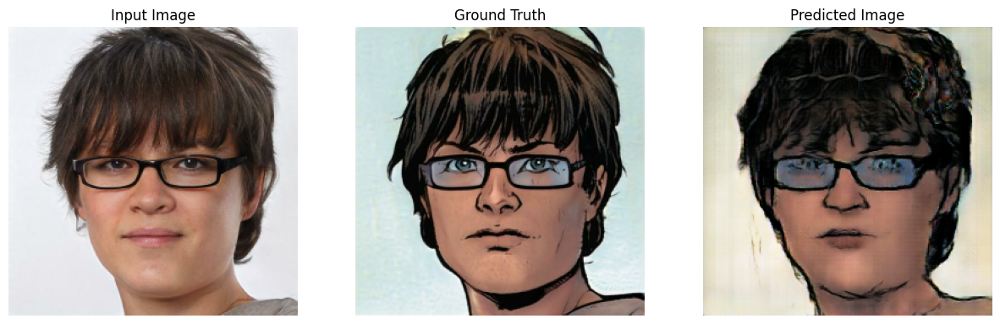

SSIM : [0.25892285]
RMSE : 0.35925713181495667


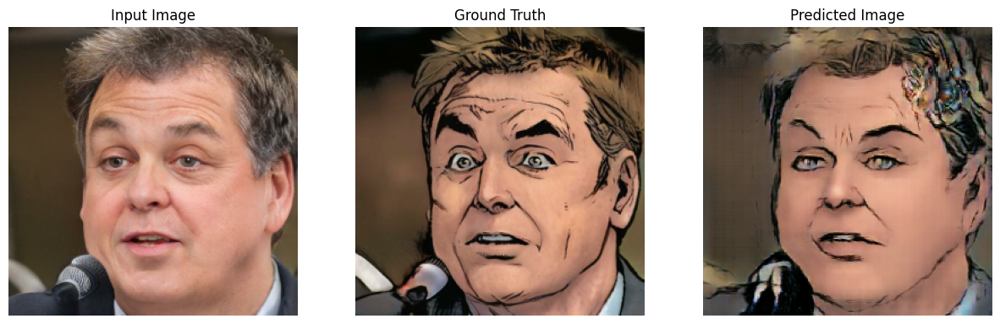

SSIM : [0.27079213]
RMSE : 0.33085301518440247


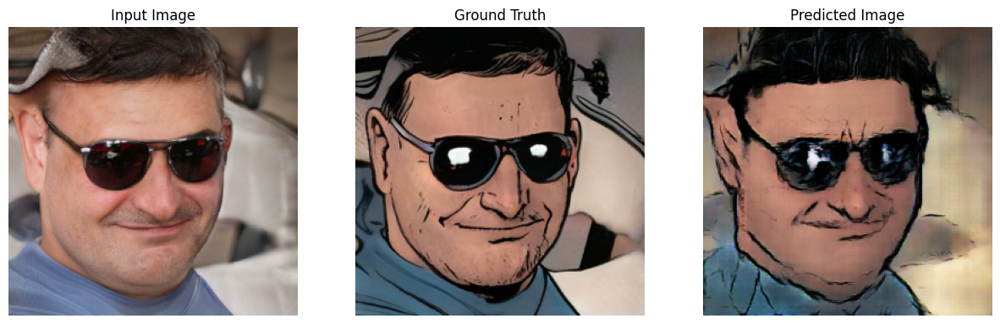

SSIM : [0.18866514]
RMSE : 0.37755298614501953


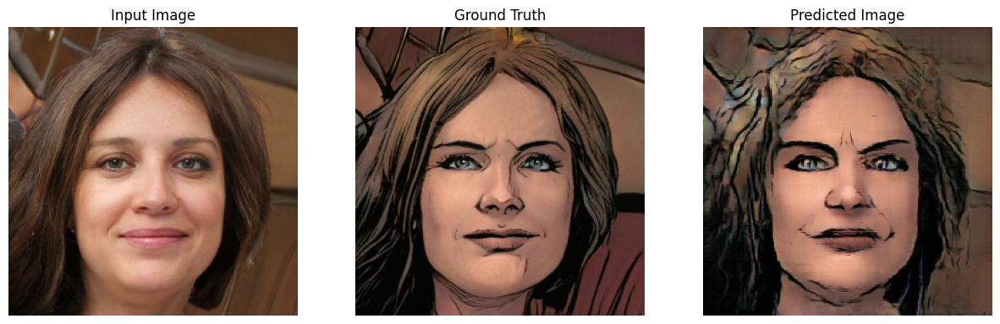

SSIM : [0.26171282]
RMSE : 0.24516437947750092


In [ ]:
for inp, tar in test_set.take(5):
  ssim,rmse= generate_images(generator, inp, tar)
  print(f"SSIM : {ssim}")
  print(f"RMSE : {rmse}")

Vamos observar as diferenças usando outras losses.


In [ ]:
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # Mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss #+ (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss

Time taken for 1000 steps: 96.23 sec



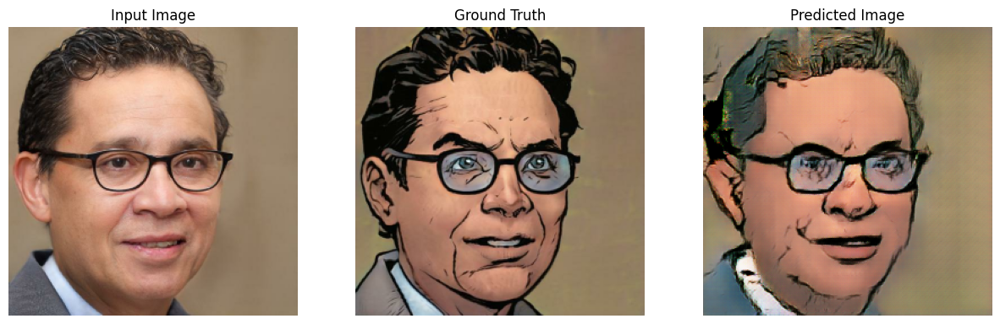

Step: 39k
SSIM: [0.21585865]
RMSE: 0.34366878867149353
....................................................................................................

In [ ]:
fit(train_dataset, test_set, steps=40000)

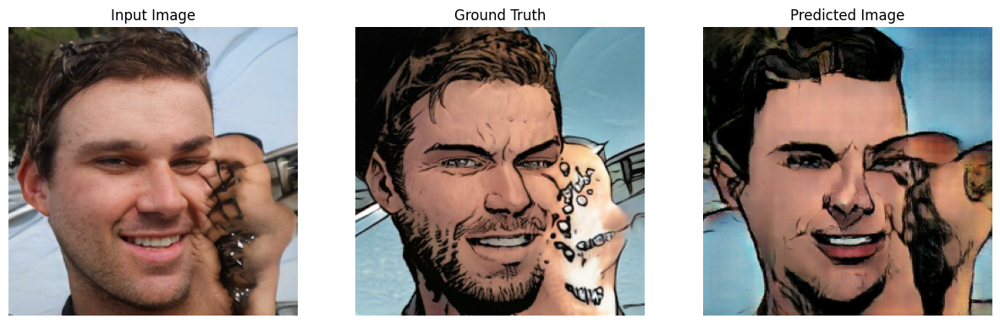

SSIM : [0.15478157]
RMSE : 0.5015624761581421


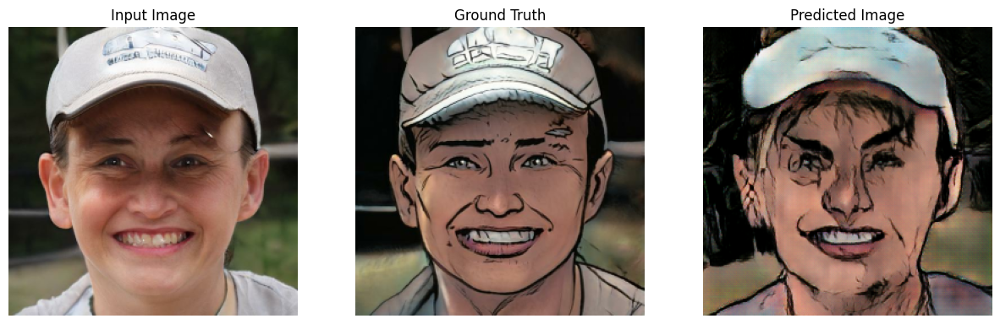

SSIM : [0.14159143]
RMSE : 0.44110170006752014


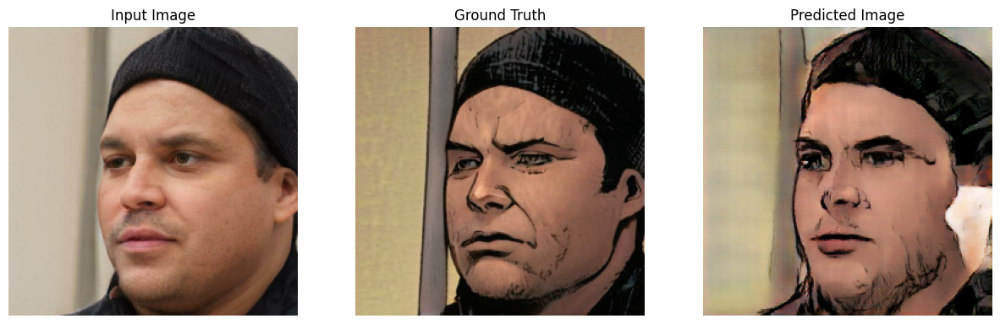

SSIM : [0.18195331]
RMSE : 0.3585846722126007


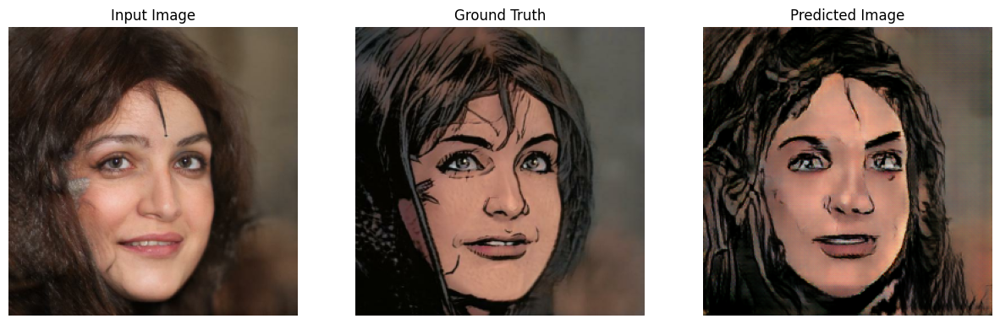

SSIM : [0.19246574]
RMSE : 0.3262619078159332


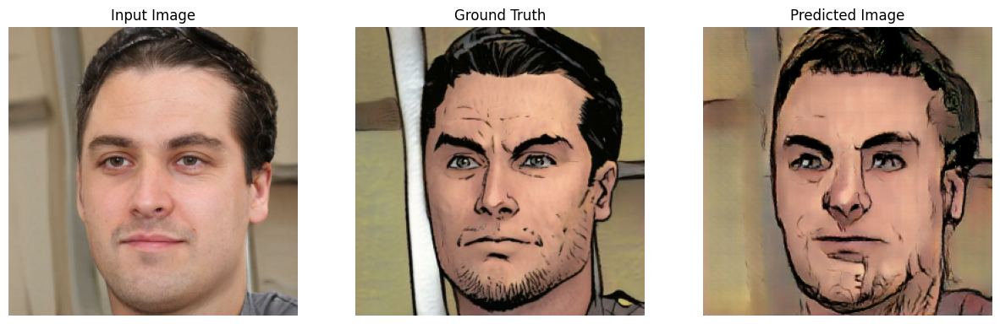

SSIM : [0.18667638]
RMSE : 0.3931540846824646


In [ ]:
for inp, tar in test_set.take(5):
  ssim,rmse= generate_images(generator, inp, tar)
  print(f"SSIM : {ssim}")
  print(f"RMSE : {rmse}")

Como podemos notar a falta da l1_loss faz a diferença na perfeição da foto, ou seja, a falta da l1_loss faz com que a imagem output não seja completamente traduzida da imagem input. E isto é observável pelos baixos valores do SSIM, que comparativamente aos obtidos com a l1 loss são efetivamente mais baixos.

In [29]:
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # Mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = l1_loss

  return total_gen_loss, gan_loss, l1_loss

Time taken for 1000 steps: 94.27 sec



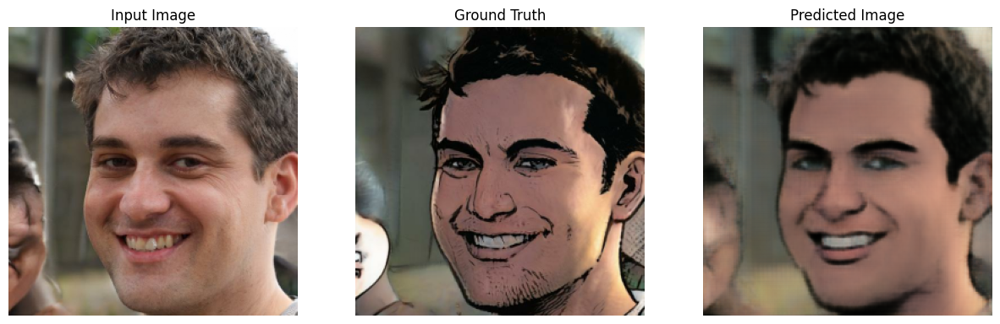

Step: 39k
SSIM: [0.3694215]
RMSE: 0.2585984170436859
....................................................................................................

In [37]:
fit(train_dataset, test_set, steps=40000)

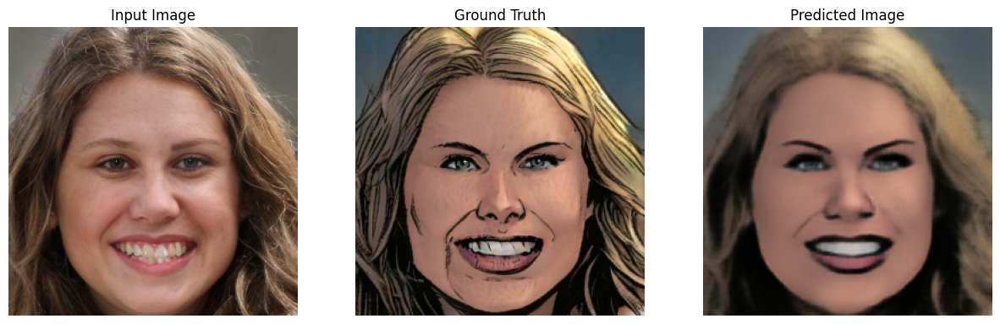

SSIM : [0.3282808]
RMSE : 0.23490631580352783


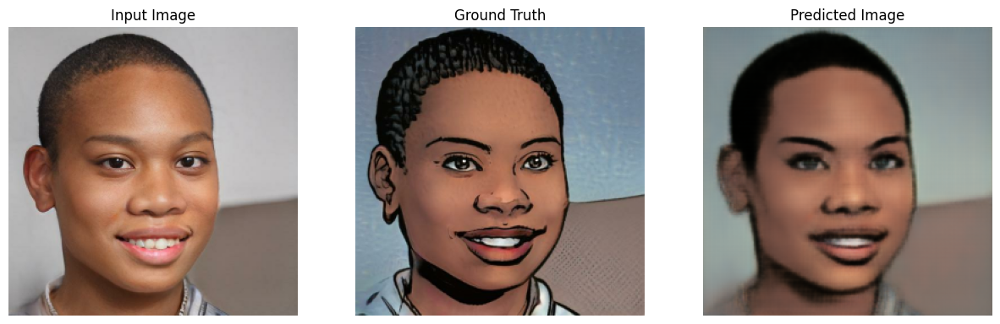

SSIM : [0.36685896]
RMSE : 0.21556217968463898


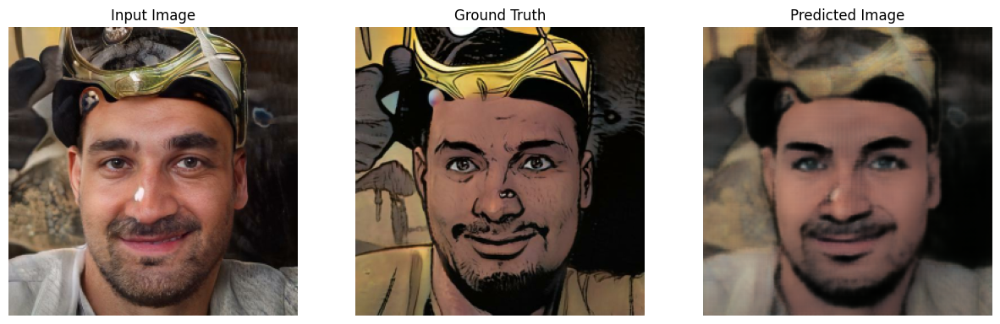

SSIM : [0.33004394]
RMSE : 0.2905815541744232


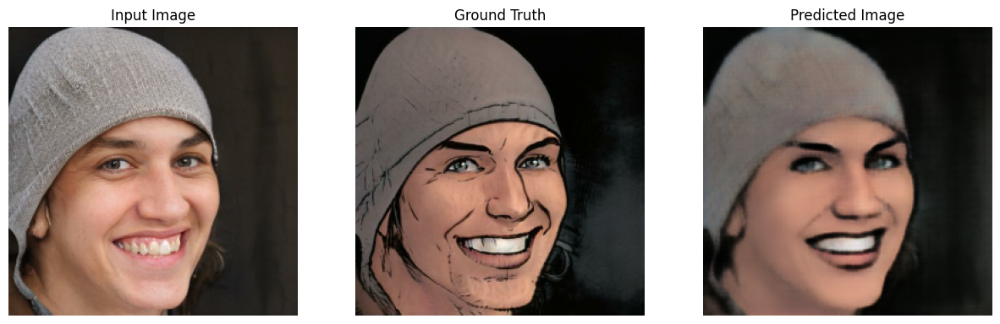

SSIM : [0.45909023]
RMSE : 0.18825240433216095


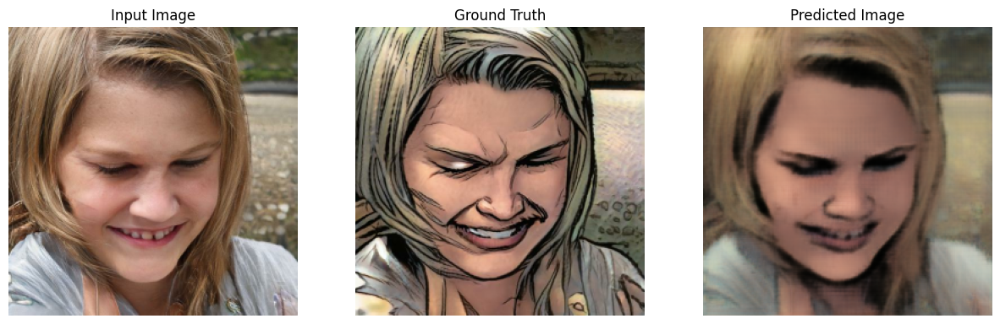

SSIM : [0.10226491]
RMSE : 0.35307982563972473


In [38]:
for inp, tar in test_set.take(5):
  ssim,rmse= generate_images(generator, inp, tar)
  print(f"SSIM : {ssim}")
  print(f"RMSE : {rmse}")

Os resultados obtidos apenas com l1 comprovam o facto de as imagens ficarem blurred.

In [31]:
def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # Mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))
  l2_loss = tf.reduce_mean(tf.math.pow(target-gen_output,2))
  total_gen_loss = l2_loss

  return total_gen_loss, gan_loss, l1_loss

Time taken for 1000 steps: 94.29 sec



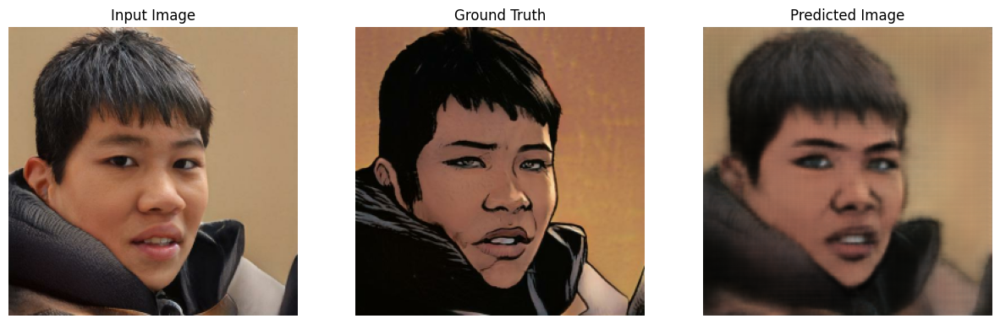

Step: 39k
SSIM: [0.39020506]
RMSE: 0.25736480951309204
....................................................................................................

In [35]:
fit(train_dataset, test_set, steps=40000)

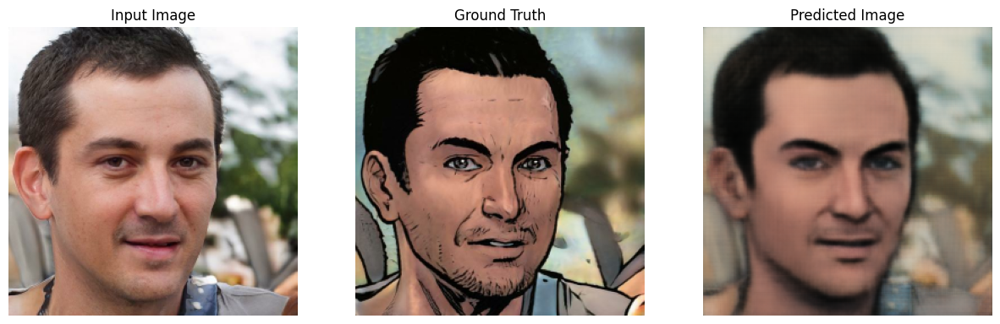

SSIM : [0.30605173]
RMSE : 0.2799614369869232


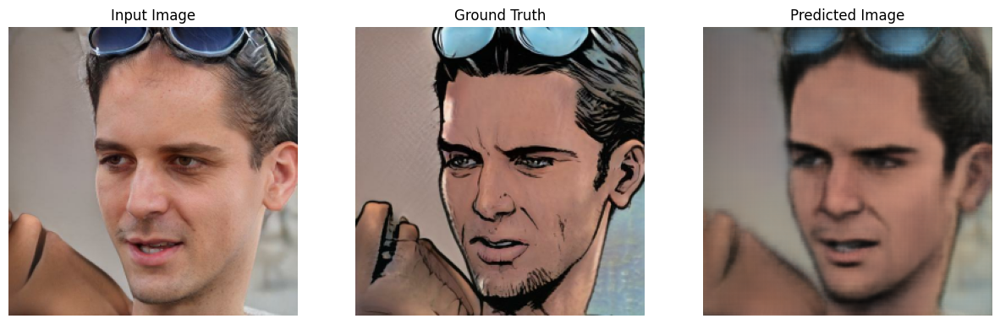

SSIM : [0.23712142]
RMSE : 0.28685271739959717


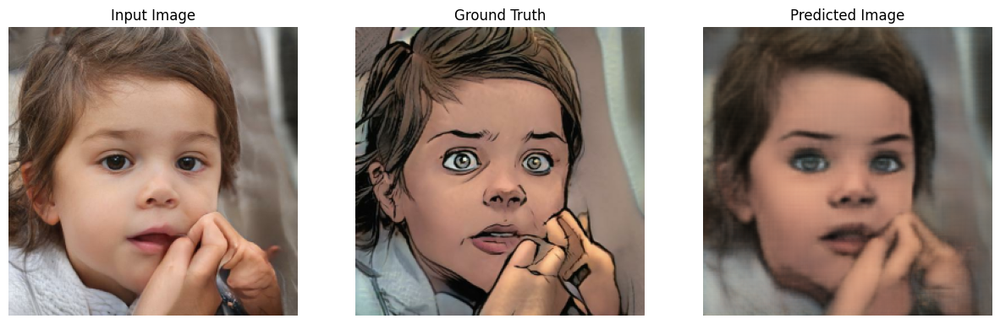

SSIM : [0.22740436]
RMSE : 0.25466546416282654


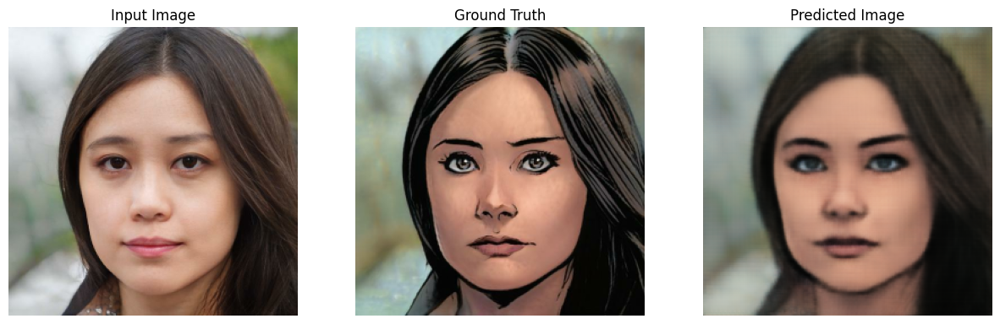

SSIM : [0.38714465]
RMSE : 0.20735502243041992


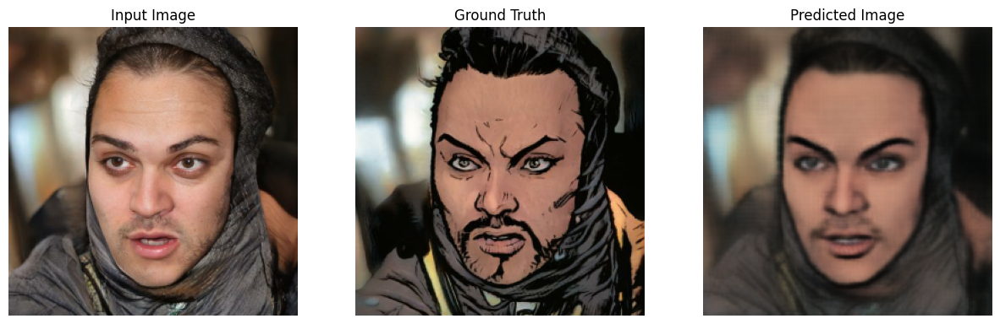

SSIM : [0.32942364]
RMSE : 0.2808152735233307


In [36]:
for inp, tar in test_set.take(5):
  ssim,rmse= generate_images(generator, inp, tar)
  print(f"SSIM : {ssim}")
  print(f"RMSE : {rmse}")

Apenas com l2 loss os resultados obtidos são ainda mais blurried o que demonstra o facto de apenas esta loss não conseguir capturar os detalhes. Porém, um detalhe interessante  de se  reparar  é o facto das métricas objetivas alcançarem melhores resultados, isto pode ser explicado pelo facto que a imagem é estruturalmente semelhante ao desejado porém não possui o mesmo efeito visual pretendido, ou seja, atingir uma cara cómica.

## Conclusão

A arquitetura Pix2Pix é bastante flexível em termos de produzir novas imagens, sendo o seu ponto principal o facto de produzir resultados interessantes e visualmente apelativos com pouco treino e com poucas imagens de Input. As diferentes funções de loss estudadas mostram as diferenças de output que são por elas geradas, sendo que pode ser interessante a aplicação de diferentes funções de loss para diferentes tipos de problema.